# Part C. EDA

Разведочный анализ данных включает:

* Знакомство с данными
* Поиск пропущенных значений
* Устранение (или замещение) выбросов
* Построение первичных гипотез о взаимосвзяи переменных
* При необходимости, снижение размерности данных

In [386]:
# Импортируем библиотеки
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import math
from sklearn import decomposition
from itertools import chain
import plotly.express as px

In [459]:
# Размер будущих графиков 
plt.rcParams['figure.figsize'] = [10, 6]

In [134]:
# Считываем данные
df = pd.read_csv('task_for_a_prod_analytics_trainee_part_c.csv')
df.head()

,hashed_user_id,user_age,user_sex,user_friends,user_communities_count,user_fans_count,user_subscriptions_count,device_brand,device_model,days_in_vk_1_week,...,messaging_total,calls_accepted,timespent_total,timespent_im,timespent_feed,timespent_photo,timespent_video,timespent_clips,timespent_audio,timespent_story
0,$1VAQ97BmCCZc,26,male,481,476,361,177,lge,LG-M250,7,...,1,0,501,0,55,0,0,0,0,0
1,$1v/FKogrWnz2,26,female,115,72,419,0,Apple,iPhone 7,7,...,23,0,0,0,0,0,0,0,0,0
2,$1eoMEtyVB3XM,26,female,297,317,2681,0,Apple,iPhone 11 Pro Max,7,...,33,0,0,0,0,0,0,0,0,0
3,$12ZhvNRMpcZU,20,male,147,130,216,0,samsung,SM-G970F,7,...,1,0,5085,101,2371,0,0,0,0,0
4,$1mD0tDgB13tk,39,male,138,311,51,33,NaN,NaN,7,...,3,0,1301,0,0,0,0,0,0,0


В наших данных 23 признака и 125893 наблюдений (пользователей):

In [135]:
df.shape

(125893, 23)

Посмотрим на базовые статистики каждой непрерывной переменной:

In [136]:
df.describe()

,user_age,user_friends,user_communities_count,user_fans_count,user_subscriptions_count,days_in_vk_1_week,days_in_vk_2_weeks,days_in_vk_4_weeks,days_in_vk_8_weeks,messaging_total,calls_accepted,timespent_total,timespent_im,timespent_feed,timespent_photo,timespent_video,timespent_clips,timespent_audio,timespent_story
count,125893.000000,125893.000000,125893.000000,125893.000000,125893.000000,125893.000000,125893.000000,125893.00000,125893.000000,125893.000000,125893.000000,125893.000000,125893.000000,125893.000000,125893.000000,125893.000000,125893.000000,125893.000000,125893.000000
mean,34.459168,222.997315,232.251865,193.345929,37.119109,6.671960,13.246829,26.35272,52.394947,53.359043,0.029350,4413.406480,625.537671,1112.688871,202.838816,296.016339,3.784261,58.317015,7.910329
std,20.505505,566.932642,386.763992,737.468913,226.131946,0.978889,2.063192,4.28400,8.952063,447.576857,0.278273,6015.906566,1837.310044,1968.557926,451.986990,1255.317444,56.554741,417.691275,62.912777
min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.00000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,22.000000,48.000000,55.000000,24.000000,1.000000,7.000000,14.000000,27.00000,54.000000,0.000000,0.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,28.000000,110.000000,119.000000,88.000000,4.000000,7.000000,14.000000,28.00000,56.000000,7.000000,0.000000,2331.000000,0.000000,146.000000,6.000000,0.000000,0.000000,0.000000,0.000000
75%,41.000000,216.000000,254.000000,198.000000,16.000000,7.000000,14.000000,28.00000,56.000000,49.000000,0.000000,6299.000000,300.000000,1512.000000,229.000000,97.000000,0.000000,0.000000,0.000000
max,120.000000,10000.000000,5000.000000,61271.000000,9115.000000,7.000000,14.000000,28.00000,56.000000,126172.000000,18.000000,265774.000000,80450.000000,33837.000000,21936.000000,49692.000000,5059.000000,30370.000000,5777.000000


Мы видим, что большую часть времени пользователи в среднем проводят за скроллингом ленты и общением с друзьями, нежели чем за просмотром историй, клипов и прослушиванием музыки.

## Возраст пользователей

Изучим одну из целевых переменных - пол пользователей.

Оказывается, что классы пользователей по полу несбалансированы: мужчин почти в 2 раза больше, чем женщин:

In [137]:
df.user_sex.value_counts()

male       80468
female     45348
unknown       77
Name: user_sex, dtype: int64

Средний возраст пользователей - 34 года. При этом мужчин в группе от 20 до 50 больше, чем женщин, а в группе от 50 до 75 - напротив. Помимо главного пика мы видим еще два небольших пика: 0 лет и в районе 120 лет. Можно предположить, что это не совсем обычные пользователи: либо они указли неверную дату рождения при регистрации, либо являются ботами (о выявлении потенциальных ботов поговорим чуть позже). В первом случае получается, что это на самом деле пользователи с неизвестным возрастом - то есть должны быть отнесены скорее к классу "Unknown".

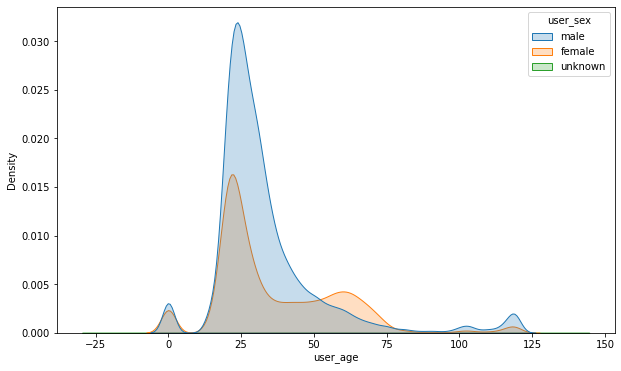

In [396]:
sns.kdeplot(x=df.user_age,hue=df.user_sex, fill=True);

Теперь для удобства разделим пользователей на группы по 10 лет каждая:

In [397]:
#divided the age into a group of 10. see last column
labels=['10-20','21-30','31-40','41-50','51-60','61-70','71-80','81-90','91-100','101-110','111-120']
df['age_group'] = pd.cut(df.user_age,bins=np.arange(10,121,10),labels=labels,right=True)
df.head()

,hashed_user_id,user_age,user_sex,user_friends,user_communities_count,user_fans_count,user_subscriptions_count,device_brand,device_model,days_in_vk_1_week,...,calls_accepted,timespent_total,timespent_im,timespent_feed,timespent_photo,timespent_video,timespent_clips,timespent_audio,timespent_story,age_group
0,$1VAQ97BmCCZc,26,male,481,476,361,177,lge,LG-M250,7,...,0,501,0,55,0,0,0,0,0,21-30
1,$1v/FKogrWnz2,26,female,115,72,419,0,Apple,iPhone 7,7,...,0,0,0,0,0,0,0,0,0,21-30
2,$1eoMEtyVB3XM,26,female,297,317,2681,0,Apple,iPhone 11 Pro Max,7,...,0,0,0,0,0,0,0,0,0,21-30
3,$12ZhvNRMpcZU,20,male,147,130,216,0,samsung,SM-G970F,7,...,0,5085,101,2371,0,0,0,0,0,10-20
4,$1mD0tDgB13tk,39,male,138,311,51,33,NaN,NaN,7,...,0,1301,0,0,0,0,0,0,0,31-40


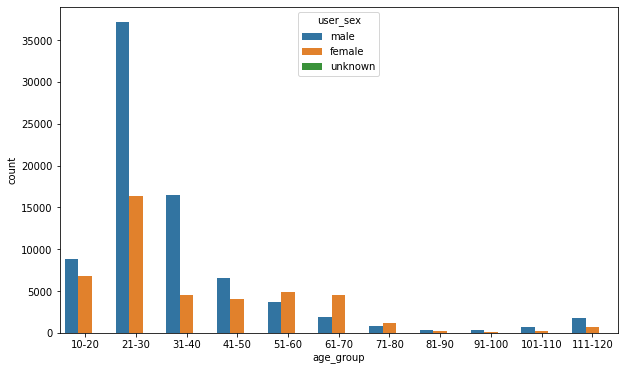

In [398]:
sns.countplot(x=df.age_group,hue=df.user_sex);

Попробуем проверить, различаются ли пользователи разного возраста и пола по количеству друзей?

<AxesSubplot:xlabel='age_group', ylabel='user_friends'>

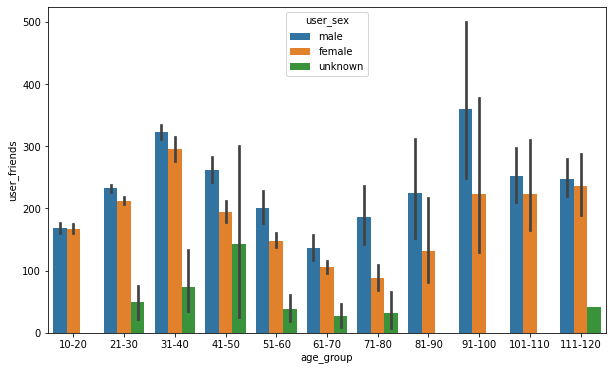

In [154]:
sns.barplot(x=df['age_group'], y=df['user_friends'], hue=df.user_sex)

Похоже, что у мужчин друзей в среднем больше, чем у женщин. Однако на этом графике мы сталкиваемся с проблемой выбросов - слишком длинные "усы" на барплоте говорят о том, что за ними могут прятаться слишком отклоняющиеся значения.

## Выбросы. Удалить нельзя оставить

Оценим визуально, так ли много выбросов в наших данных с помощью боксплотов для каждой переменной:

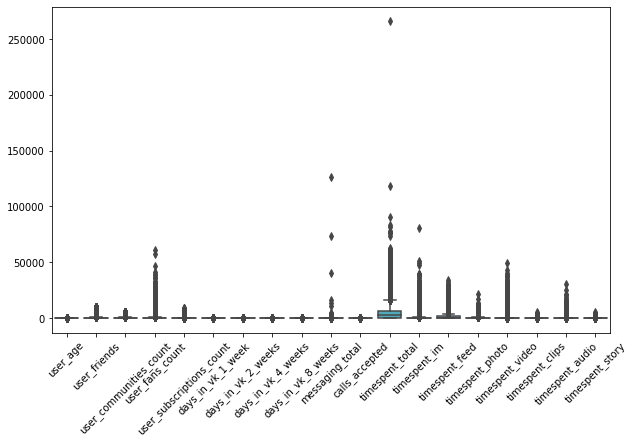

In [399]:
ax = sns.boxplot(data=df, orient='v', width=0.8)
plt.setp(ax.get_xticklabels(), rotation=45);

На примере переменной ```timespent_total``` особенно хорошо заметно, что присутствуют выбросы: один из пользователей проводит 250000 секунд в день в социальной сети.

При этом в некоторых переменных большая часть значений равна 0, как, например, в ```calls_accepted```. По всей видимости, это фича не очень популярна среди пользователей. Если мы отбросим все выбросы, то останутся только нулевые значеня. Поэтому к таким переменным мы не будем применять отсеивание выбросов.

In [143]:
df['calls_accepted'].value_counts()

0     123636
1       1513
2        418
3        174
4         64
5         37
6         26
8          8
7          7
10         3
13         2
11         2
9          2
18         1
Name: calls_accepted, dtype: int64

Для всех остальных переменных мы удалим все значения, отклоняющиеся более чем на 3 стандартных отклонения от среднего:

In [432]:
from scipy import stats

def drop_numerical_outliers(data, z_thresh=3):
    # Constrains will contain `True` or `False` depending on if it is a value below the threshold.
    constrains = data.select_dtypes(include=['int64']).apply(lambda x: np.abs(stats.zscore(x)) < z_thresh).all(axis=1)
    # Drop (inplace) values set to be rejected
    data_out = data.drop(data.index[~constrains])
    return data_out

df['calls_accepted'] = df['calls_accepted'].astype("int32")
df_clear = drop_numerical_outliers(data=df)
df_clear['calls_accepted'] = df_clear['calls_accepted'].astype("int64")
df_clear

,hashed_user_id,user_age,user_sex,user_friends,user_communities_count,user_fans_count,user_subscriptions_count,device_brand,device_model,days_in_vk_1_week,...,calls_accepted,timespent_total,timespent_im,timespent_feed,timespent_photo,timespent_video,timespent_clips,timespent_audio,timespent_story,age_group
0,$1VAQ97BmCCZc,26,male,481,476,361,177,lge,LG-M250,7,...,0,501,0,55,0,0,0,0,0,21-30
1,$1v/FKogrWnz2,26,female,115,72,419,0,Apple,iPhone 7,7,...,0,0,0,0,0,0,0,0,0,21-30
3,$12ZhvNRMpcZU,20,male,147,130,216,0,samsung,SM-G970F,7,...,0,5085,101,2371,0,0,0,0,0,10-20
4,$1mD0tDgB13tk,39,male,138,311,51,33,NaN,NaN,7,...,0,1301,0,0,0,0,0,0,0,31-40
5,$1WYpYdge7ipo,25,female,65,20,269,1,HONOR,LLD-L31,7,...,0,3731,0,452,303,0,0,0,0,21-30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125885,$1rqN8jRhtY/s,0,female,131,796,51,15,Apple,iPhone 7,7,...,0,0,0,0,0,0,0,0,0,NaN
125886,$1qfdyYFSwYj6,23,male,49,260,18,18,xiaomi,Redmi 5 Plus,7,...,0,11025,1152,4980,108,487,0,529,0,21-30
125889,$1u.Y5CEEZr0Q,28,male,330,183,99,5,NaN,NaN,7,...,0,7306,1846,3460,676,632,0,0,0,21-30
125890,$1y3yJsQ4qK5s,0,female,177,1193,25,13,HUAWEI,MAR-LX3A,7,...,0,1851,881,334,217,20,0,0,0,NaN


После удаления аутлайеров: 

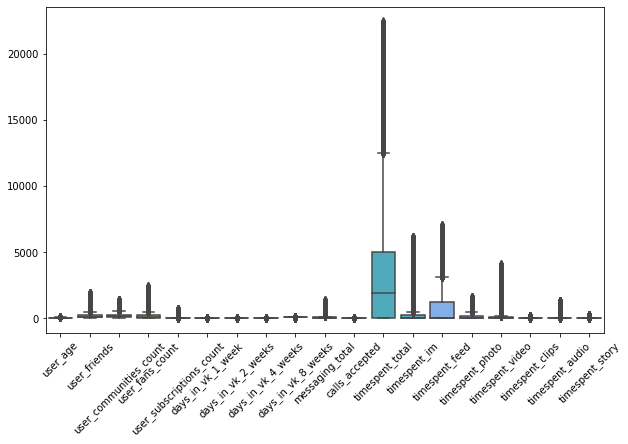

In [406]:
ax = sns.boxplot(data=df_clear, orient='v', width=0.8)
plt.setp(ax.get_xticklabels(), rotation=45);

Интересно, что при удалении аутлайеров мы полностью удалили пользователей из возрастных групп более 100 лет. Выходит, что хотя бы по одной переменной эти пользователи сильно отличались от остальных - и, возможно, были ботами.

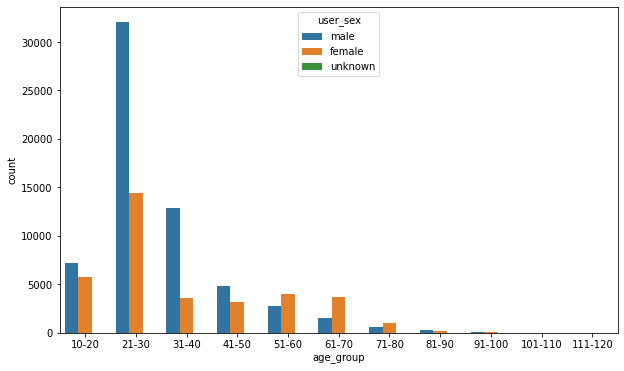

In [334]:
sns.countplot(x=df_clear.age_group,hue=df_clear.user_sex);

Кроме того, после удаления аутлайров разница в количестве друзей у мужчин и женщин сгладилась. Это также может говорить о том, что мы удалили ботов - у них обычно очень много друзей. Но при этом мы могли удалить действительно очень популярных людей - знаменитостей, блогеров и т.д.

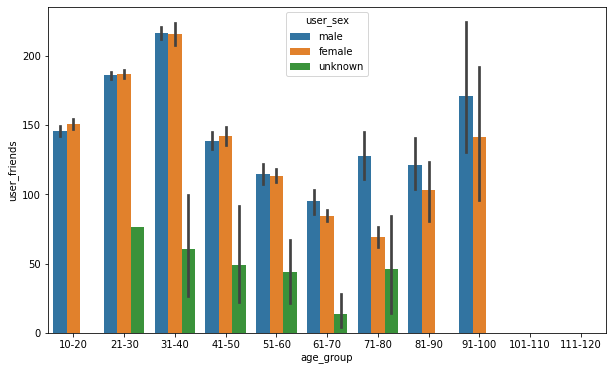

In [335]:
sns.barplot(x=df_clear['age_group'], y=df_clear['user_friends'], hue=df_clear.user_sex);

При этом в группе ```91-100``` мы по-прежнему видим длинные усы и высокую активность. Давайте посмотрим на эту группу повнимательнее:

In [407]:
df_clear.query('age_group == "91-100"').sort_values(by="timespent_total", ascending=False)

,hashed_user_id,user_age,user_sex,user_friends,user_communities_count,user_fans_count,user_subscriptions_count,device_brand,device_model,days_in_vk_1_week,...,calls_accepted,timespent_total,timespent_im,timespent_feed,timespent_photo,timespent_video,timespent_clips,timespent_audio,timespent_story,age_group
110555,$1VBb8tVnUfqE,92,male,63,468,105,21,NaN,NaN,7,...,0,18881,0,0,0,0,0,0,0,91-100
39069,$1IlAmh7gZ5uQ,93,male,638,530,108,57,NaN,NaN,7,...,0,18766,0,0,0,0,0,0,0,91-100
6093,$1q1JxzlqXFcM,94,male,117,8,48,0,OPPO,CPH1931,7,...,0,15309,3012,347,383,28,0,157,10,91-100
12666,$1KIF5q08eF6w,95,male,0,50,0,1,NaN,NaN,7,...,0,13649,0,0,0,0,0,0,0,91-100
53237,$13hQbWl4YOGI,94,male,43,219,184,14,samsung,SM-A525F,7,...,0,12596,5557,2311,523,3,4,833,4,91-100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48391,$1nCnNPWrdoIM,92,male,260,40,87,107,Apple,iPhone 5S (Global),7,...,0,0,0,0,0,0,0,0,0,91-100
43869,$1yRAOxp6LuEw,91,male,72,140,28,6,Apple,iPhone 6,7,...,0,0,0,0,0,0,0,0,0,91-100
42551,$1pEsUis9fy76,93,male,83,64,60,0,Apple,iPhone XR,7,...,0,0,0,0,0,0,0,0,0,91-100
40113,$1a4z3Xv72bC.,91,female,25,46,5,0,Apple,iPhone 6s,6,...,0,0,0,0,0,0,0,0,0,91-100


Интересно, что у юзеров с неопределенной моделью устройства очень высокая общая активность, при этом они не тратят время ни на что из приведенных видов деятельности. На что же тогда они тратят время? Можно, конечно, предположить, что это действительно пожилые люди и находятся он-лайн в фоновом режиме. Но можно предположить, что это боты.

Оценим, различаются ли группы с известной моделью устройства и без по общем активности, а также по суммарной активности, которую мы посчитаем как сумму всех видов деятельности.

In [433]:
df_clear['without_device'] = df_clear['device_model'].isnull().astype("int64")
df_clear['time_active'] = df_clear['timespent_im'] + df_clear['timespent_feed'] + df_clear['timespent_photo'] + df_clear['timespent_video'] + df_clear['timespent_clips'] + df_clear['timespent_story']

<AxesSubplot:xlabel='without_device', ylabel='timespent_total'>

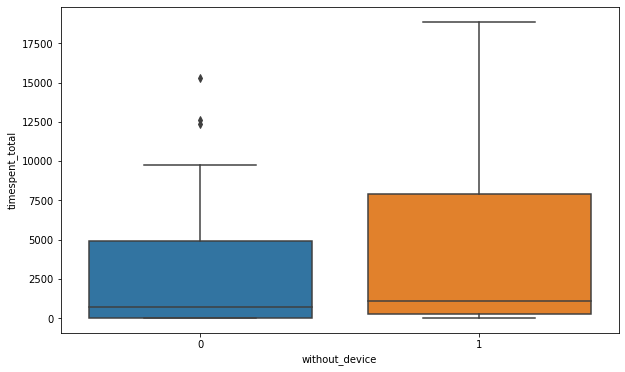

In [411]:
sns.boxplot(x='without_device', y='timespent_total', data=df_clear.query('age_group == "91-100"'), orient='v', width=0.8)

<AxesSubplot:xlabel='without_device', ylabel='time_active'>

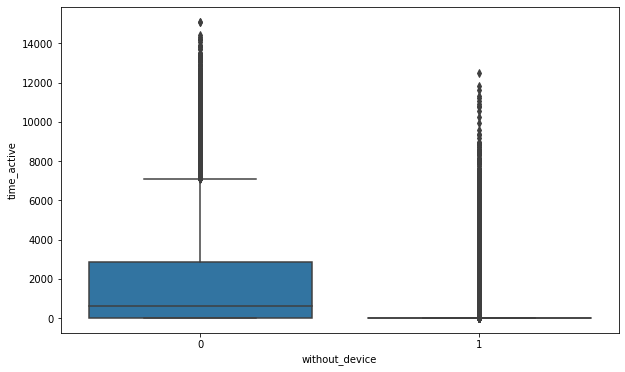

In [412]:
sns.boxplot(x='without_device', y='time_active', data=df_clear, orient='v', width=0.8)

Выходит, что общая активность и активность по деятельности у юзеров с устройством примерно равна. А вот для юзеров без устройства кардинально различается. Тогда удалим всех юзеров, у которых нет устройства, слишком высокая общая активность, и нулевая активность по видам деятельности.

In [434]:
bots = df_clear.query('without_device == 1 and time_active == 0 and timespent_total > 0')
df_clear = df_clear.query('without_device == 0 and time_active > 0 and timespent_total > 0')

In [435]:
df_clear = df_clear.drop('without_device', 1).drop('time_active', 1)

В итоге распределение переменной ```timespent_total``` для данных без выбросов и ботов (по моему предположению) выглядит так:

<AxesSubplot:>

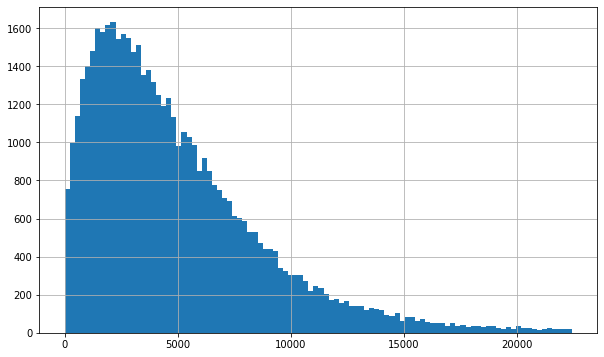

In [460]:
df_clear.timespent_total.hist(bins=100)

Разделим пользователей по общей активности на две группы: активные и нет. Это пригодится нам для анализа главных компонент (PCA).

In [437]:
df_clear['is_active'] = (df_clear['timespent_total'] > 5000).astype("int64")
df_clear

,hashed_user_id,user_age,user_sex,user_friends,user_communities_count,user_fans_count,user_subscriptions_count,device_brand,device_model,days_in_vk_1_week,...,timespent_total,timespent_im,timespent_feed,timespent_photo,timespent_video,timespent_clips,timespent_audio,timespent_story,age_group,is_active
0,$1VAQ97BmCCZc,26,male,481,476,361,177,lge,LG-M250,7,...,501,0,55,0,0,0,0,0,21-30,0
3,$12ZhvNRMpcZU,20,male,147,130,216,0,samsung,SM-G970F,7,...,5085,101,2371,0,0,0,0,0,10-20,1
5,$1WYpYdge7ipo,25,female,65,20,269,1,HONOR,LLD-L31,7,...,3731,0,452,303,0,0,0,0,21-30,0
7,$1KcByhj1JXdE,60,male,7,18,0,1,Redmi,M2004J19C,7,...,6920,0,2218,311,25,0,0,0,51-60,1
9,$1qMo6Q8oT0jg,30,male,196,160,70,11,samsung,SM-J600F,7,...,2997,0,727,282,1005,0,0,4,21-30,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125883,$1XhvjQVpDvhs,41,male,153,96,28,15,xiaomi,Redmi Note 4,7,...,9117,66,6026,916,1331,0,0,0,41-50,1
125884,$1T9.BChtFkYQ,22,male,154,77,132,72,samsung,SM-G973F,7,...,4911,540,1053,339,0,0,0,0,21-30,0
125886,$1qfdyYFSwYj6,23,male,49,260,18,18,xiaomi,Redmi 5 Plus,7,...,11025,1152,4980,108,487,0,529,0,21-30,1
125890,$1y3yJsQ4qK5s,0,female,177,1193,25,13,HUAWEI,MAR-LX3A,7,...,1851,881,334,217,20,0,0,0,NaN,0


## Корелляция между признаками

Вернемся к главному вопросу: какие признаки могут бфть скореллированы с возрастом пользователей? Ответив на этот вопрос, мы сможем примерно обозначить набор предикторов, которые могут оказаться важными для предсказания возраста в дальнейшем.

Будем использовать ранговую корелляцию Спирмена, так как большинство признаков распределены не нормально.

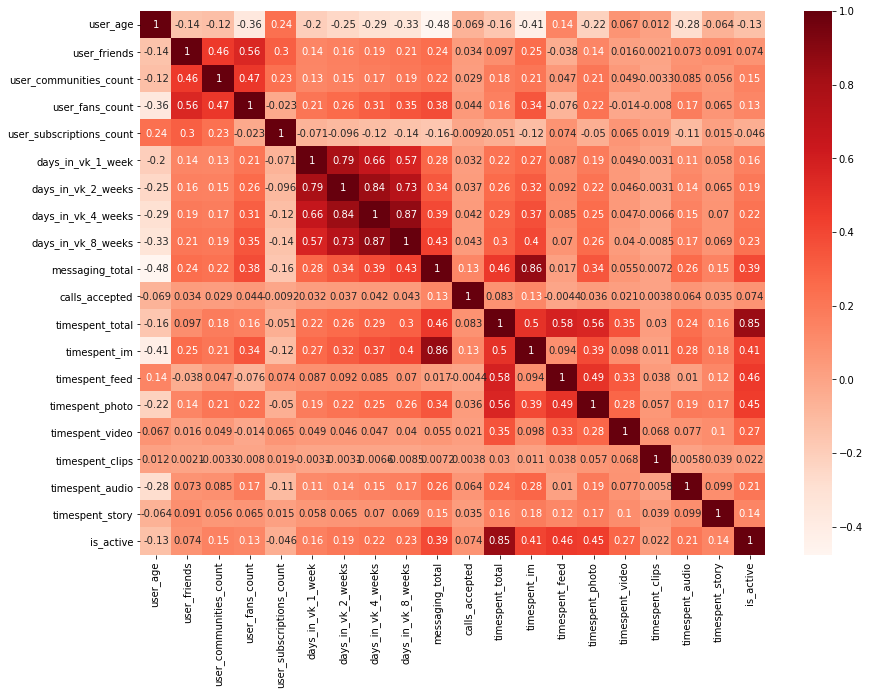

In [439]:
plt.rcParams['figure.figsize'] = [14, 10]
plt.rcParams['font.size'] = 10
sns.heatmap(df_clear.corr(method='spearman'), annot=True, cmap = 'Reds');

Во-первых, мы видим, что наиболее скореллированными с возрастом фичами оказались: ```messaging_total```, ```timespent_im```, ```user_fans_count```. Все они отрицательно кореллируют с возрастом. Наиболее сильная положительная корелляция наблюдается для ```user_subscriptions_count```.

Посмотрим внимательно на эти фичи.

<AxesSubplot:xlabel='age_group', ylabel='user_subscriptions_count'>

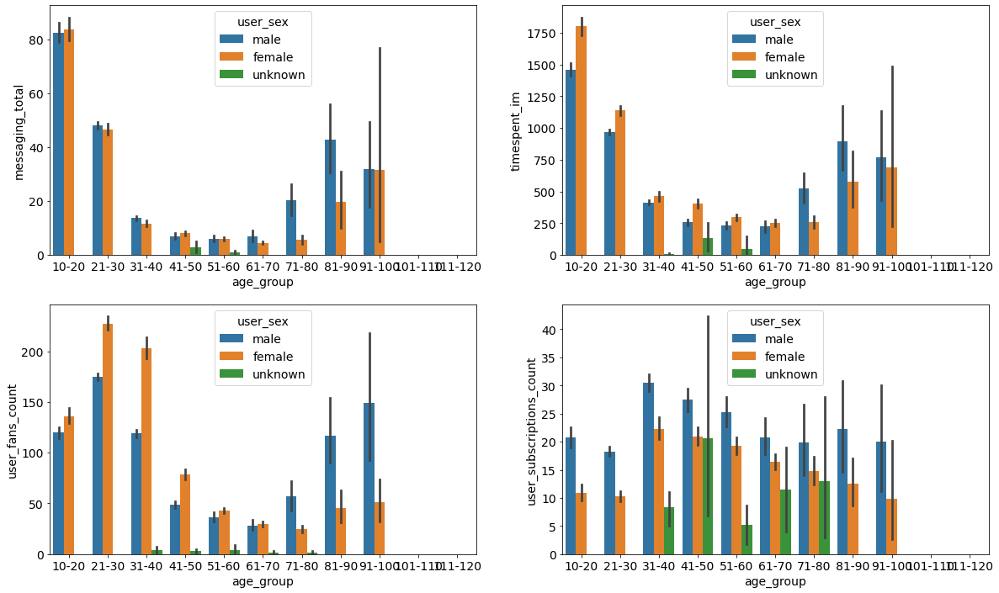

In [428]:
plt.rcParams['figure.figsize'] = [20, 12]
plt.rcParams['font.size'] = 14
figure, axes = plt.subplots(nrows = 2, ncols = 2)

sns.barplot(x='age_group', y='messaging_total', hue='user_sex', data=df_clear, ax=axes[0][0])
sns.barplot(x='age_group', y='timespent_im', hue='user_sex', data=df_clear, ax=axes[0][1])
sns.barplot(x='age_group', y='user_fans_count', hue='user_sex', data=df_clear, ax=axes[1][0])
sns.barplot(x='age_group', y='user_subscriptions_count', hue='user_sex', data=df_clear, ax=axes[1][1])

На первом графике видно, что с возрастом резко уменьшается количество сообщений. Однако, после 70 лет, активность вновь вырастает (может, это опять аномальная активность ботов, или людей, поставивших не свой возраст?). Такая же ситуация характерна и для время, проведенное за общением в социальной сети. Это неудивительно - эти фичи действительно скореллированы (r2 = 0.86). Обе эти фичи могут быть хорошими предикторами для возраста. Однако, вероятно, стоит предсказывать возраст по группам: например, для людей до 70 и после. Количество человек, подписанных на пользователя максимально в возрастной группе 21-30, а у более взрослых людей этот показатель постепенно снижается. После 70-ти мы вновь наблюдаем скачок этого показателя. Количество подписок пользователя на первый взгляд не так уж хорошо варьирует среди возрастных групп.

Помимо возраста, некоторые из этих фичей могут быть хорошими фичами для классификации пользователей по полу. Например, до 70-ти лет, девушки больше времени тратят на написание сообщения, чем мужчины. При этом количество сообщений для них примерно равно (1-й график). Может быть, девушки имеют тенденцию долго писать или редактировать сообщения, или просто ждать, пока им ответят, не выходя из мессенджера?

Инетересно, что количество подписок больше у мужчин, чем у женщин, и это характерно для всех возрастных групп. Ну а количество подписчиков больше всего у девушек, причем опять же до 70-ти лет. Эти признаки могут быть хорошими для классификации пользователей по полу.

Помимо выявления потенциальных предикторов будущей модели, матрица корелляции несет и другую важную информацию: некоторые фичи сильно скореллированы друг с другом. Можно выделить 3 блока скореллированнных фичей:

* суммарное время, проведенное вконтакте за последние 1-8 недель
* признаки по времени, затраченному на определенный вид деятельности
* социальная активность: кол-во друзей, подписчиков и тд

Мультиколлинеарность предикторов в регрессионной модели может снизить ее качество. Поэтому лучше по возможности снижать размерность данных: например, оставлять только некую усредненную фичу среди блока скореллированных, или же провести снижение размерности при помощи анализа главных компонент (PCA).

## PCA (Principal Component Analysis)

Первым делм подготовим датасет для PCA и таргетные переменные: пол, возраст и среднюю активность (для чего нужна последняя - узнаете дальше)

In [450]:
X = df_clear.query('user_age >= 10 and user_sex != "unknown"').select_dtypes(include=['int64']).drop('user_age', 1).drop('is_active', 1)
y_sex = df_clear.query('user_age >= 10 and user_sex != "unknown"')['user_sex']
y_age = df_clear.query('user_age >= 10 and user_sex != "unknown"')['age_group']
y_active = df_clear.query('user_age >= 10 and user_sex != "unknown"')['is_active']

X.reset_index(drop=True, inplace=True)
y_sex.reset_index(drop=True, inplace=True)
y_age.reset_index(drop=True, inplace=True)
y_active.reset_index(drop=True, inplace=True)

Воспользуемся PCA из библиотеки ```scikit-learn```

In [451]:
pca = decomposition.PCA(n_components=3)
X_centered = X - X.mean(axis=0)
pca.fit(X_centered)
X_pca = pca.transform(X_centered)

Объединим результаты в датасет:

In [452]:
principalDf = pd.DataFrame(data = X_pca, columns = ['principal_component_1', 'principal_component_2', 'principal_component_3'])
finalDf = pd.concat([principalDf, y_sex, y_age, y_active], axis = 1)
finalDf

,principal_component_1,principal_component_2,principal_component_3,user_sex,age_group,is_active
0,-4761.145303,581.929907,292.041155,male,21-30,0
1,146.107400,-893.612242,294.120113,male,10-20,1
2,-1555.907677,595.401206,837.586356,female,21-30,0
3,1881.304030,-599.613476,840.327425,male,51-60,1
4,-2169.929610,211.786545,652.131586,male,21-30,0
...,...,...,...,...,...,...
48934,1492.817491,-525.418286,893.251872,female,41-50,1
48935,4859.732026,-3772.988049,-188.430041,male,41-50,1
48936,-210.344229,436.296547,381.059361,male,21-30,0
48937,6598.289538,-2065.179318,-322.626186,male,21-30,1


Теперь посмотрим, насколько хорошо каждая компонента объясняет разнообразие в данных:

In [464]:
for i, component in enumerate(pca.components_):
    print("{} component: {}% of initial variance".format(i + 1, 
          round(100 * pca.explained_variance_ratio_[i], 2)))

1 component: 82.75% of initial variance
2 component: 9.64% of initial variance
3 component: 4.87% of initial variance


Получилось неплохо: первая компонента объясняет сразу 82.75% разнообразия. Осталось понять, какие фичи вносят вклад в эту компоненту. Может, это как раз возраст пользователей?

In [461]:
fig = px.scatter_3d(
    X_pca, x=0, y=1, z=2, color=finalDf['age_group'],
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

Похоже, что нет... мы не можем выделить отдельные возрастные группы. Посмотрим на них отдельно:

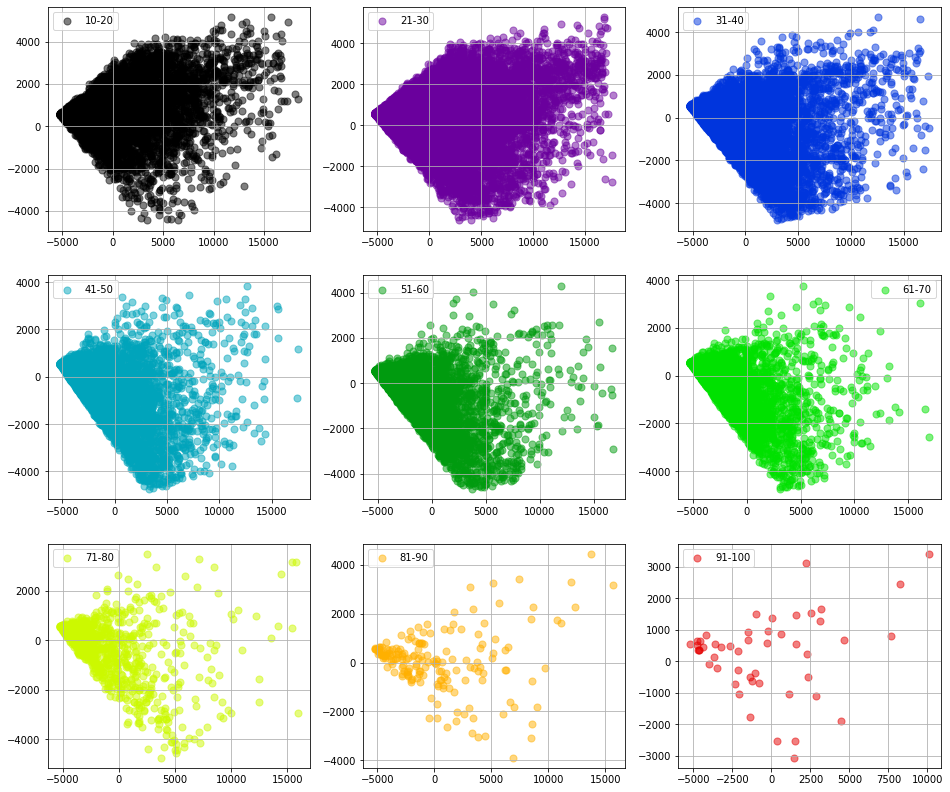

In [454]:
plt.rcParams['figure.figsize'] = [16, 14]
figure, axes = plt.subplots(nrows = 3, ncols = 3)
new_axes = chain.from_iterable(axes)
targets = ['10-20', '21-30', '31-40', '41-50', '51-60', '61-70', '71-80', '81-90', '91-100']
cmap=plt.cm.get_cmap('nipy_spectral', 10) 

for target, ax, i in zip(targets, new_axes, range(9)):
    ax.grid()
    color = cmap(i)
    indicesToKeep = finalDf['age_group'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal_component_1']
               , finalDf.loc[indicesToKeep, 'principal_component_2']
               , s = 50, alpha=0.5, label=target, color=color)
    ax.legend()

Возрастные группы в новом пространстве двух компонент скорее разделяются по количеству человек в группе, чем по форме.

Может, тогда, пользователи хорошо разделятся по полу?

In [462]:
fig = px.scatter_3d(
    X_pca, x=0, y=1, z=2, color=finalDf['user_sex'],
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

К сожалению, опять не то. Посмотрим, какие фичи вносят вклад в компоненты:

In [465]:
for i, component in enumerate(pca.components_):
    print(" + ".join("%.3f x %s" % (value, name)
                     for value, name in zip(component,
                                            X.columns)))

0.003 x user_friends + 0.007 x user_communities_count + 0.005 x user_fans_count + 0.000 x user_subscriptions_count + 0.000 x days_in_vk_1_week + 0.000 x days_in_vk_2_weeks + 0.000 x days_in_vk_4_weeks + 0.000 x days_in_vk_8_weeks + 0.007 x messaging_total + 0.000 x calls_accepted + 0.966 x timespent_total + 0.153 x timespent_im + 0.203 x timespent_feed + 0.036 x timespent_photo + 0.039 x timespent_video + 0.000 x timespent_clips + 0.006 x timespent_audio + 0.001 x timespent_story
0.015 x user_friends + 0.011 x user_communities_count + 0.023 x user_fans_count + -0.001 x user_subscriptions_count + 0.000 x days_in_vk_1_week + 0.000 x days_in_vk_2_weeks + 0.000 x days_in_vk_4_weeks + 0.000 x days_in_vk_8_weeks + 0.022 x messaging_total + 0.000 x calls_accepted + 0.121 x timespent_total + 0.435 x timespent_im + -0.889 x timespent_feed + -0.031 x timespent_photo + -0.050 x timespent_video + -0.000 x timespent_clips + 0.013 x timespent_audio + 0.000 x timespent_story
-0.002 x user_friends + -

Оказывается, наибольший вклад в первую компоненту вносит фича ```timespent_total```. Похоже, что разнообразие в нашей выборке определяется активность юзеров в социальной сети:

In [463]:
import plotly.express as px

fig = px.scatter_3d(
    X_pca, x=0, y=1, z=2, color=finalDf['is_active'],
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

Действительно, активные пользователи лежат в области положительных значений первой компоненты, а неактивные - в отрицательной.

Покажем то же самое с использованием t-SNE

In [373]:
%%time
from sklearn.manifold import TSNE
tsne = TSNE(random_state=17)

X_tsne = tsne.fit_transform(X)

CPU times: user 26min 7s, sys: 2min 1s, total: 28min 9s
Wall time: 9min 29s


In [374]:
tsne_df = pd.DataFrame(data = X_tsne, columns = ['principal_component_1', 'principal_component_2'])
finalDf_tsne = pd.concat([tsne_df, y_sex, y_age, y_active], axis = 1)
finalDf_tsne

,principal_component_1,principal_component_2,user_sex,age_group,is_active
0,-51.349617,14.166814,male,21-30,0
1,38.551624,-24.830671,male,10-20,1
2,1.468884,-19.051710,female,21-30,0
3,40.153385,2.372454,male,51-60,1
4,-10.115060,-24.003370,male,21-30,0
...,...,...,...,...,...
48934,28.569628,-0.794440,female,41-50,1
48935,19.111763,37.430073,male,41-50,1
48936,15.855577,-16.706545,male,21-30,0
48937,10.679695,42.941734,male,21-30,1


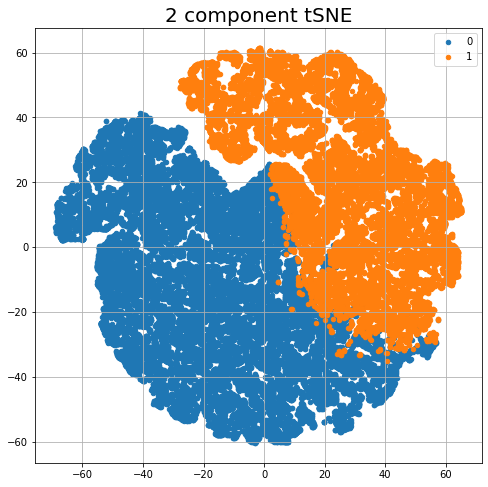

In [376]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_title('2 component tSNE', fontsize = 20)
targets = [0, 1]
for target in targets:
    indicesToKeep = finalDf_tsne['is_active'] == target
    ax.scatter(finalDf_tsne.loc[indicesToKeep, 'principal_component_1']
               , finalDf_tsne.loc[indicesToKeep, 'principal_component_2']
               , s = 20)
ax.legend(targets)
ax.grid()

Мы видим, что выделяются два кластера: активные и неактивные пользователя, хотя пространства между ними нет.

t-SNE также подтверждает и отсутствие разделения на возрастные группы:

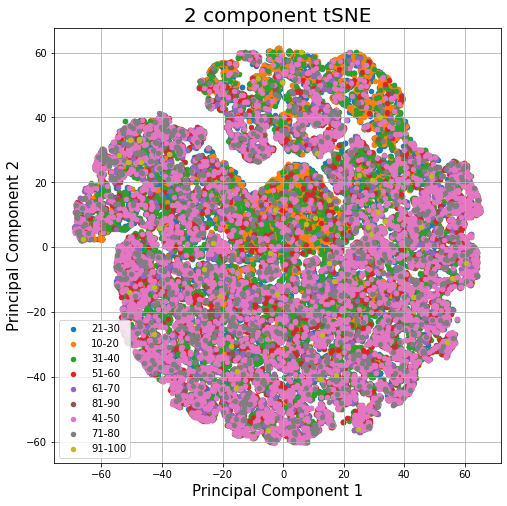

In [254]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component tSNE', fontsize = 20)
targets = ['21-30', '10-20', '31-40', '51-60', '61-70', '81-90', '41-50', '71-80', '91-100']
for target in targets:
    indicesToKeep = finalDf_tsne['age_group'] == target
    ax.scatter(finalDf_tsne.loc[indicesToKeep, 'principal_component_1']
               , finalDf_tsne.loc[indicesToKeep, 'principal_component_2']
               , s = 20)
ax.legend(targets)
ax.grid()

Тем не менее, мы получили главные компоненты, которые в дальнейшем можно использовать в качестве новых фичей для классификации. При этом уже первые 2 компоненты объясняют 90% дисперсии данных:

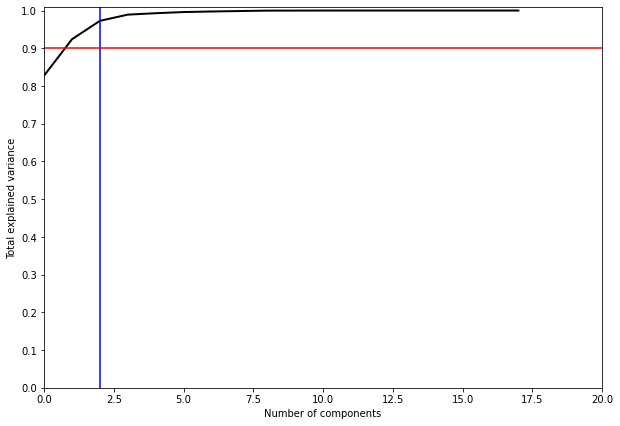

In [471]:
pca = decomposition.PCA().fit(X)

plt.figure(figsize=(10,7))
plt.plot(np.cumsum(pca.explained_variance_ratio_), color='k', lw=2)
plt.xlabel('Number of components')
plt.ylabel('Total explained variance')
plt.xlim(0, 20)
plt.yticks(np.arange(0, 1.1, 0.1))
plt.axvline(2, c='b')
plt.axhline(0.9, c='r')
plt.show();

## Выводы

Итак, в ходе разведочного анализа данных мы:

* избавились от выбросов
* постарались понять природу ботов и избавиться от них
* поняли, что в данных могут быть скрытые положительные наблюдения (пользователи, указавшие не свой возраст)
* определили набор наиболее значимых потенциальных предикторов для предсказания пола и возраста
* учли возможную мультиколлинеарность предикторов, снизив размерность данных
* определили, что суммарная активность юзеров болше всего объясняет их разнообразие